# UKPN Constraint Breach Time Visualization

This notebook creates an interactive time-animated map showing:
1. **ECR Sites**: Flexible and connected generation sites (static layer)
2. **Constraint Breaches**: Time-animated breaches firing over time  
3. **Curtailment Events**: Time-synchronized curtailment events with DER IDs

The goal is to visually correlate which DER gets curtailed when specific constraint breaches occur nearby.


In [127]:
# Imports and setup
import os
import pandas as pd
import numpy as np
import folium
from folium import plugins
import json
from datetime import datetime, timedelta
import warnings
warnings.filterwarnings('ignore')

# Set up paths
WORKDIR = "/Users/aron/project-overflow"
ECR_PATH = os.path.join(WORKDIR, "ukpn-embedded-capacity-register.csv")
BREACHES_PATH = os.path.join(WORKDIR, "ukpn-constraint-breaches-history.csv")
CURTAILMENT_PATH = os.path.join(WORKDIR, "ukpn-curtailment-events-site-specific.csv")
CONSTRAINTS_GEOLOCATED_PATH = os.path.join(WORKDIR, "outputs", "constraints_geolocated.csv")
OUTPUT_DIR = os.path.join(WORKDIR, "outputs")

# Verify files exist
for path in [ECR_PATH, BREACHES_PATH, CURTAILMENT_PATH, CONSTRAINTS_GEOLOCATED_PATH]:
    assert os.path.exists(path), f"Missing file: {path}"

print("Setup complete. Ready to create time visualization.")


Setup complete. Ready to create time visualization.


In [128]:
# Load datasets
print("=" * 60)
print("LOADING DATASETS")
print("=" * 60)

# Load ECR data and filter for flexible + connected
ecr_df = pd.read_csv(ECR_PATH)
print(f"Loaded {len(ecr_df)} ECR sites")

# Filter for flexible and connected sites
flexible_connected = ecr_df[
    (ecr_df['Flexible Connection (Yes/No)'] == 'Yes') & 
    (ecr_df['Connection Status'] == 'Connected')
].copy()

# Clean coordinates
flexible_connected['latitude'] = pd.to_numeric(flexible_connected['Latitude'], errors='coerce')
flexible_connected['longitude'] = pd.to_numeric(flexible_connected['Longitude'], errors='coerce')
flexible_connected = flexible_connected.dropna(subset=['latitude', 'longitude'])

print(f"Filtered to {len(flexible_connected)} flexible + connected ECR sites with coordinates")

# Load constraint geolocations
constraints_geo = pd.read_csv(CONSTRAINTS_GEOLOCATED_PATH)
print(f"Loaded {len(constraints_geo)} geolocated constraints")

# Load constraint breaches
breaches_df = pd.read_csv(BREACHES_PATH)
print(f"Loaded {len(breaches_df)} constraint breach records")

# Load curtailment events  
curtailment_df = pd.read_csv(CURTAILMENT_PATH)
print(f"Loaded {len(curtailment_df)} curtailment events")

# Parse timestamps
breaches_df['start_time_utc'] = pd.to_datetime(breaches_df['start_time_utc'])
breaches_df['end_time_utc'] = pd.to_datetime(breaches_df['end_time_utc'])
curtailment_df['start_time_utc'] = pd.to_datetime(curtailment_df['start_time_utc'])
curtailment_df['end_time_utc'] = pd.to_datetime(curtailment_df['end_time_utc'])

print("Data loading complete.")


LOADING DATASETS
Loaded 1240 ECR sites
Filtered to 36 flexible + connected ECR sites with coordinates
Loaded 148 geolocated constraints
Loaded 13214 constraint breach records
Loaded 12112 curtailment events
Data loading complete.


In [129]:
# First, enhance the geolocated constraints with constraint_id mapping
print("=" * 60)
print("ENHANCING GEOLOCATED CONSTRAINTS WITH IDS")
print("=" * 60)

# Load the real-time meter readings to get constraint_id mappings
rt_constraints_df = pd.read_csv(os.path.join(WORKDIR, "ukpn-constraints-real-time-meter-readings.csv"))
print(f"Loaded {len(rt_constraints_df)} real-time constraint readings")

# Create constraint_id to constraint_description mapping
constraint_id_mapping = rt_constraints_df[['constraint_id', 'constraint_description']].drop_duplicates()
print(f"Found {len(constraint_id_mapping)} unique constraint_id mappings")

# Add constraint_id to the geolocated constraints
constraints_geo_enhanced = constraints_geo.merge(
    constraint_id_mapping,
    on='constraint_description',
    how='left'
)

print(f"Enhanced {len(constraints_geo_enhanced)} geolocated constraints with constraint_ids")
print(f"Successfully mapped {constraints_geo_enhanced['constraint_id'].notna().sum()} out of {len(constraints_geo_enhanced)} constraints")

# Save the enhanced version
enhanced_file = os.path.join(OUTPUT_DIR, 'constraints_geolocated_with_ids.csv')
constraints_geo_enhanced.to_csv(enhanced_file, index=False)
print(f"Saved enhanced geolocated constraints to: {enhanced_file}")

# Show sample mappings
print("\nSample constraint_id mappings:")
print(constraints_geo_enhanced[['constraint_id', 'constraint_description', 'latitude', 'longitude']].head())

# Merge constraint breaches with geolocations using constraint_id
print("\n" + "=" * 60)
print("MERGING BREACHES WITH GEOLOCATIONS USING CONSTRAINT_ID")
print("=" * 60)

# Merge breaches with constraint geolocations using constraint_id
breaches_with_location = breaches_df.merge(
    constraints_geo_enhanced[['constraint_id', 'constraint_description', 'latitude', 'longitude', 'constraint_type']],
    on='constraint_id',
    how='inner',
    suffixes=('_breach', '_geo')
)

print(f"Successfully geolocated {len(breaches_with_location)} out of {len(breaches_df)} breaches")
print(f"Success rate: {len(breaches_with_location)/len(breaches_df)*100:.1f}%")

# Show sample of geolocated breaches
print("\nSample geolocated breaches:")
print(breaches_with_location[['start_time_utc', 'constraint_id', 'constraint_description_breach', 'latitude', 'longitude']].head())


ENHANCING GEOLOCATED CONSTRAINTS WITH IDS
Loaded 159 real-time constraint readings
Found 159 unique constraint_id mappings
Enhanced 148 geolocated constraints with constraint_ids
Successfully mapped 148 out of 148 constraints
Saved enhanced geolocated constraints to: /Users/aron/project-overflow/outputs/constraints_geolocated_with_ids.csv

Sample constraint_id mappings:
                 constraint_id  \
0    0C1068_919-CCT_CONSTR-CCT   
1    0C1068_934-CCT_CONSTR-CCT   
2    0C3048_912-CCT_CONSTR-CCT   
3  0C3048_936-CCT~O_CONSTR-CCT   
4  0C3048_938-CCT~F_CONSTR-CCT   

                              constraint_description   latitude  longitude  
0  Bramford 132kV  - BURY GRID tee STOWMARKET GRI...  51.669452   0.680717  
1  Bramford 132kV - BURY GRID tee STOWMARKET GRID...  51.669452   0.680717  
2  Lawford 132kV -  BRAMFORD GRID tee IPSWICH GRI...  52.062998   1.099408  
3        Lawford 132kV -  CLACTON GRID 2 (PYA  No.2)  51.916697   1.018790  
4               Lawford 132kV - BRAMF

In [130]:
# Create base map
print("=" * 60)
print("CREATING BASE MAP")
print("=" * 60)

# Calculate map center from ECR sites
center_lat = flexible_connected['latitude'].mean()
center_lon = flexible_connected['longitude'].mean()

print(f"Map center: {center_lat:.4f}, {center_lon:.4f}")

# Initialize folium map
m = folium.Map(
    location=[center_lat, center_lon],
    zoom_start=8,
    tiles='OpenStreetMap'
)

# Add ECR sites as static blue markers
ecr_group = folium.FeatureGroup(name="ECR Sites (Flexible + Connected)")

for idx, row in flexible_connected.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        popup=f"""
        <b>ECR Site</b><br>
        Customer: {row['Customer Name']}<br>
        Site: {row['Customer Site']}<br>
        Energy Source: {row['Energy Source 1']}<br>
        Capacity: {row['Energy Source & Energy Conversion Technology 1 - Registered Capacity (MW)']} MW
        """,
        color='blue',
        fill=True,
        fillColor='lightblue',
        fillOpacity=0.7,
        weight=2
    ).add_to(ecr_group)

ecr_group.add_to(m)
print(f"Added {len(flexible_connected)} ECR sites to map")

# Create DER grid layout positioned over Ireland
# Define Ireland bounding box (approximate)
ireland_bounds = {
    'north': 55.5,
    'south': 51.0,
    'west': -10.5,
    'east': -5.5
}

# Get all unique DERs and their summary data
unique_ders = curtailment_df.groupby('der_name').agg({
    'total_der_access_reduction_kWh': 'sum',
    'scheme_name': lambda x: x.iloc[0],  # Get first scheme name
    'start_time_utc': 'count'  # Count events
}).rename(columns={'start_time_utc': 'event_count'}).sort_values('total_der_access_reduction_kWh', ascending=False)

print(f"Creating grid layout for {len(unique_ders)} unique DERs over Ireland")

# Calculate grid dimensions
total_ders = len(unique_ders)
grid_cols = int(np.ceil(np.sqrt(total_ders)))
grid_rows = int(np.ceil(total_ders / grid_cols))

# Calculate spacing
lat_spacing = (ireland_bounds['north'] - ireland_bounds['south']) / (grid_rows + 1)
lon_spacing = (ireland_bounds['east'] - ireland_bounds['west']) / (grid_cols + 1)

# Create DER position mapping for later use in animation
der_positions = {}

print(f"Arranging DERs in {grid_rows}x{grid_cols} grid over Ireland")

for i, (der_name, der_data) in enumerate(unique_ders.iterrows()):
    # Calculate grid position
    row = i // grid_cols
    col = i % grid_cols
    
    # Calculate geographic position
    lat = ireland_bounds['south'] + (row + 1) * lat_spacing
    lon = ireland_bounds['west'] + (col + 1) * lon_spacing
    
    # Store position for animation
    der_positions[der_name] = {
        'lat': lat,
        'lon': lon,
        'total_events': der_data['event_count'],
        'total_kwh': der_data['total_der_access_reduction_kWh'],
        'scheme': der_data['scheme_name']
    }

print(f"Created position mapping for {len(der_positions)} DERs")

# Create base map centered on Ireland to show both ECR sites and DER grid
print("\n" + "=" * 60)
print("CREATING BASE MAP")
print("=" * 60)

# Center map on Ireland to show both ECR sites and DER grid
ireland_center_lat = 53.0
ireland_center_lon = -8.0

print(f"Map center: {ireland_center_lat:.4f}, {ireland_center_lon:.4f} (Ireland)")

# Create base map centered on Ireland
m = folium.Map(
    location=[ireland_center_lat, ireland_center_lon],
    zoom_start=6,
    tiles='OpenStreetMap'
)

# Add ECR sites as static markers
ecr_group = folium.FeatureGroup(name="ECR Sites (Flexible + Connected)")

print(f"Adding {len(flexible_connected)} ECR sites to map")

for _, site in flexible_connected.iterrows():
    folium.CircleMarker(
        location=[site['latitude'], site['longitude']],
        radius=5,  # Smaller radius to reduce overlap
        popup=f"""
        <b>ECR Site</b><br>
        Customer: {site['Customer Name']}<br>
        Site: {site['Customer Site']}<br>
        Energy Source: {site['Energy Source 1']}<br>
        Capacity: {site['Already Connected - Maximum Export Capacity (MW)']} MW<br>
        Status: {site['Connection Status']}<br>
        Flexible: {site['Flexible Connection (Yes/No)']}
        """,
        color='navy',
        fill=True,
        fillColor='lightblue',
        fillOpacity=0.4,  # More transparent to allow orange to show through
        weight=1,  # Thinner border
        zIndexOffset=-100  # Put ECR sites below other markers
    ).add_to(ecr_group)

ecr_group.add_to(m)
print(f"Added {len(flexible_connected)} ECR sites to map")


CREATING BASE MAP
Map center: 52.2215, 0.5582
Added 36 ECR sites to map
Creating grid layout for 43 unique DERs over Ireland
Arranging DERs in 7x7 grid over Ireland
Created position mapping for 43 DERs

CREATING BASE MAP
Map center: 53.0000, -8.0000 (Ireland)
Adding 36 ECR sites to map
Added 36 ECR sites to map


In [131]:
# Prepare time series data for animation
print("=" * 60)
print("PREPARING TIME SERIES DATA")
print("=" * 60)

# Group breaches by hour for animation
breaches_with_location['hour'] = breaches_with_location['start_time_utc'].dt.floor('H')
curtailment_df['hour'] = curtailment_df['start_time_utc'].dt.floor('H')

# Get unique hours that have either breaches or curtailments
breach_hours = set(breaches_with_location['hour'].unique())
curtailment_hours = set(curtailment_df['hour'].unique())
all_hours = sorted(breach_hours.union(curtailment_hours))

print(f"Found {len(all_hours)} unique hours with activity")
print(f"Date range: {min(all_hours)} to {max(all_hours)}")

# Add static DER grid as a base layer (always visible)
print("Adding static DER grid to map...")

der_grid_group = folium.FeatureGroup(name="DER Grid (Static)")

for der_name, der_pos in der_positions.items():
    folium.CircleMarker(
        location=[der_pos['lat'], der_pos['lon']],
        radius=3,
        popup=f"""
        <b>DER: {der_name}</b><br>
        <b>Scheme:</b> {der_pos['scheme']}<br>
        <hr>
        <b>Historical Summary:</b><br>
        Total Events: {der_pos['total_events']}<br>
        Total Energy Lost: {der_pos['total_kwh']:.0f} kWh<br>
        <hr>
        <i>Watch for fire icon during curtailment events</i>
        """,
        color='darkred',
        fill=True,
        fillColor='red',
        fillOpacity=0.7,
        weight=1
    ).add_to(der_grid_group)

der_grid_group.add_to(m)
print(f"Added {len(der_positions)} DERs to static grid")

# Create time series features for animation
time_features = []

for hour in all_hours:
    # Get breaches for this hour
    hour_breaches = breaches_with_location[breaches_with_location['hour'] == hour]
    
    # Get curtailments for this hour
    hour_curtailments = curtailment_df[curtailment_df['hour'] == hour]
    
    # Add constraint breach markers with overlapping DER information
    for _, breach in hour_breaches.iterrows():
        # Find DERs that are curtailed at the same time as this breach
        concurrent_ders = hour_curtailments['der_name'].tolist() if len(hour_curtailments) > 0 else []
        
        if concurrent_ders:
            der_info = f"""
            <hr><b>🔥 CONCURRENT CURTAILMENTS ({len(concurrent_ders)})</b><br>
            """ + "<br>".join([f"• {der}" for der in concurrent_ders[:10]])  # Show max 10 DERs
            if len(concurrent_ders) > 10:
                der_info += f"<br>... and {len(concurrent_ders) - 10} more"
        else:
            der_info = "<hr><b>No concurrent curtailments</b>"
        
        breach_feature = {
            "type": "Feature",
            "properties": {
                "time": hour.isoformat(),
                "popup": f"""
                <div style="color: blue; font-weight: bold;">
                ⚡ CONSTRAINT BREACH<br>
                Time: {breach['start_time_utc'].strftime('%Y-%m-%d %H:%M')}<br>
                Constraint ID: {breach['constraint_id']}<br>
                Constraint: {breach['constraint_description_breach']}<br>
                Voltage: {breach['constraint_voltage_kV']} kV<br>
                Duration: {breach['duration_hours']:.2f} hours<br>
                Energy Reduction: {breach['total_der_access_reduction_kWh']:.0f} kWh
                {der_info}
                <small><i>Note: Both breaches and curtailments show as blue pins</i></small>
                </div>
                """,
                "radius": 10
            },
            "geometry": {
                "type": "Point",
                "coordinates": [breach['longitude'], breach['latitude']]
            }
        }
        time_features.append(breach_feature)
    
    # Add fire icon markers for curtailed DERs (these will flash)
    curtailment_count = 0
    for _, curtailment in hour_curtailments.iterrows():
        der_name = curtailment['der_name']
        if der_name in der_positions:
            der_pos = der_positions[der_name]
            curtailment_count += 1
            
            # Note: TimestampedGeoJson has limited styling support and only shows blue markers
            # Both curtailment and breach events will appear as blue pins
            curtailment_marker_feature = {
                "type": "Feature", 
                "properties": {
                    "time": hour.isoformat(),
                    "popup": f"""
                    <div style="text-align: center; color: red; font-weight: bold;">
                    🔥 DER CURTAILED 🔥<br>
                    <b>DER:</b> {der_name}<br>
                    <b>Time:</b> {hour.strftime('%Y-%m-%d %H:%M')}<br>
                    <b>Duration:</b> {curtailment['duration_hours']:.2f} hours<br>
                    <b>Energy Lost:</b> {curtailment['total_der_access_reduction_kWh']:.0f} kWh<br>
                    <b>Scheme:</b> {curtailment['scheme_name']}<br>
                    <small><i>Note: Appears as blue pin due to TimestampedGeoJson limitations</i></small>
                    </div>
                    """,
                    "radius": 12
                },
                "geometry": {
                    "type": "Point",
                    "coordinates": [der_pos['lon'], der_pos['lat']]
                }
            }
            time_features.append(curtailment_marker_feature)
    
    # Debug: Print curtailment info for this hour
    if len(hour_curtailments) > 0:
        print(f"Hour {hour.strftime('%Y-%m-%d %H:%M')}: {len(hour_curtailments)} curtailments, {curtailment_count} with valid positions")

# Create timestamped geojson
timestamped_geojson = {
    "type": "FeatureCollection", 
    "features": time_features
}

# Count different types of features for debugging
breach_features = [f for f in time_features if "CONSTRAINT BREACH" in f["properties"]["popup"]]
curtailment_features = [f for f in time_features if "DER CURTAILED" in f["properties"]["popup"]]

print(f"Created {len(time_features)} total timestamped features:")
print(f"  - {len(breach_features)} constraint breach markers")
print(f"  - {len(curtailment_features)} curtailment fire markers")

if len(curtailment_features) > 0:
    print("Sample curtailment marker:")
    sample = curtailment_features[0]
    print(f"  Position: {sample['geometry']['coordinates']}")
    print(f"  Properties keys: {list(sample['properties'].keys())}")
    print(f"  Color: {sample['properties'].get('color', 'Not set')}")
    print(f"  Fill Color: {sample['properties'].get('fillColor', 'Not set')}")
    print(f"  Radius: {sample['properties'].get('radius', 'Not set')}")
    print(f"  Fill Opacity: {sample['properties'].get('fillOpacity', 'Not set')}")
    print(f"  Weight: {sample['properties'].get('weight', 'Not set')}")
else:
    print("⚠️  WARNING: No curtailment features found!")

print("Animation ready!")


PREPARING TIME SERIES DATA
Found 3493 unique hours with activity
Date range: 2023-01-01 01:00:00+00:00 to 2025-08-25 21:00:00+00:00
Adding static DER grid to map...
Added 43 DERs to static grid
Hour 2023-01-01 01:00: 5 curtailments, 5 with valid positions
Hour 2023-01-01 02:00: 6 curtailments, 6 with valid positions
Hour 2023-01-01 03:00: 1 curtailments, 1 with valid positions
Hour 2023-01-01 04:00: 6 curtailments, 6 with valid positions
Hour 2023-01-01 06:00: 7 curtailments, 7 with valid positions
Hour 2023-01-02 20:00: 2 curtailments, 2 with valid positions
Hour 2023-01-03 10:00: 4 curtailments, 4 with valid positions
Hour 2023-01-03 14:00: 1 curtailments, 1 with valid positions
Hour 2023-01-03 15:00: 5 curtailments, 5 with valid positions
Hour 2023-01-03 16:00: 6 curtailments, 6 with valid positions
Hour 2023-01-04 12:00: 6 curtailments, 6 with valid positions
Hour 2023-01-04 14:00: 5 curtailments, 5 with valid positions
Hour 2023-01-04 15:00: 1 curtailments, 1 with valid positions


In [132]:
# Add time animation to map
print("=" * 60)
print("ADDING TIME ANIMATION")
print("=" * 60)

# Add TimestampedGeoJson plugin with supported navigation controls
plugins.TimestampedGeoJson(
    timestamped_geojson,
    period='PT1H',  # 1 hour intervals
    duration='PT1H',  # Each event shows for 1 hour
    transition_time=200,  # Animation transition time in milliseconds
    auto_play=False,  # Start paused
    add_last_point=False,
    max_speed=20,  # Maximum playback speed
    loop=False,  # Don't loop by default
    date_options='YYYY-MM-DD HH:mm:ss',
    time_slider_drag_update=True  # Update map when dragging slider
).add_to(m)

print("Time animation added to map")


ADDING TIME ANIMATION
Time animation added to map


In [139]:
# Create curtailment information display
print("=" * 60)
print("ADDING CURTAILMENT INFORMATION")
print("=" * 60)

# Create a summary of curtailments by hour for display
curtailment_summary = curtailment_df.groupby('hour').agg({
    'der_name': ['count', lambda x: ', '.join(x.unique())],
    'total_der_access_reduction_kWh': 'sum'
})

curtailment_summary.columns = ['der_count', 'der_list', 'total_kwh']

# Add legend and information with curtailment events info
legend_html = f"""
<div style="position: fixed; 
            top: 10px; right: 10px; width: 380px; height: auto; 
            background-color: white; border:2px solid grey; z-index:9999; 
            font-size:12px; padding: 10px; overflow-y: auto; max-height: 85vh;">
<h4>🇮🇪 UKPN DER Grid Visualization</h4>

<p><b>Legend:</b></p>
<p><span style="color:blue;">●</span> ECR Sites (Flexible + Connected): {len(flexible_connected)} sites</p>
<p><span style="color:red;">●</span> DER Grid (Static): {len(der_positions)} which we don't know the names or locations of</p>
<p> Constraint Breaches (Time-animated blue folium markers)</p>
<p>DER Curtailments (Time-animated blue folium markers)</p>

<p><b>⚠️ Technical Note:</b></p>
<p><b>• Location</b>: Breaches appear at grid constraint locations<br>
<b>• Location</b>: Curtailments appear at DER grid positions over Ireland<br>
<b>• Popup Content</b>: Click pins to see whether it's a breach or curtailment</p>

<p><b>🎮 Navigation Controls:</b></p>
<p><b>• Time Slider</b>: Drag to jump to any time period<br>
<b>• Play/Pause Button</b>: Auto-advance through time<br>
<b>• Step Buttons</b>: Use ⏮️ ⏭️ to move forward/backward<br>
<b>• Speed Control</b>: Adjust playback speed up to 20x<br>
<b>• Real-time Updates</b>: Map updates as you drag the slider</p>

<hr>
<h5>Curtailment Events Summary</h5>
<p><b>Total Events:</b> {len(curtailment_df)}<br>
<b>Unique DERs:</b> {curtailment_df['der_name'].nunique()}<br>
<b>Total Energy Lost:</b> {curtailment_df['total_der_access_reduction_kWh'].sum():,.0f} kWh</p>

<p><b>Top Curtailed DERs:</b></p>
"""

# Add top 5 most curtailed DERs
top_ders = curtailment_df.groupby('der_name').agg({
    'total_der_access_reduction_kWh': 'sum',
    'der_name': 'count'
}).rename(columns={'der_name': 'event_count'}).sort_values('total_der_access_reduction_kWh', ascending=False).head(5)

for der_name, row in top_ders.iterrows():
    legend_html += f"<small>• {der_name}: {row['event_count']} events, {row['total_der_access_reduction_kWh']:,.0f} kWh</small><br>"

legend_html += """
</div>
"""

m.get_root().html.add_child(folium.Element(legend_html))

print("Information panel added")


ADDING CURTAILMENT INFORMATION
Information panel added


DER CURTAILMENT ANALYSIS

DER CURTAILMENT STATISTICS
Total DERs with curtailment events: 43
Total curtailment events: 12,112
Total energy lost: 76,430,415 kWh
Date range: 2023-01-01 01:11:33+00:00 to 2025-08-25 21:18:24+00:00

TOP 15 MOST IMPACTED DERs (by total energy lost):
          event_count  total_energy_lost_kwh  avg_energy_per_event  \
der_name                                                             
DER43             624            11308143.55              18122.02   
DER31            1262             9876941.23               7826.42   
DER29             232             6040760.44              26037.76   
DER24             308             5435727.91              17648.47   
DER13             167             4727993.18              28311.34   
DER21             190             4446808.38              23404.25   
DER42              45             3966962.34              88154.72   
DER9             1127             3907582.64               3467.24   
DER1             1550  

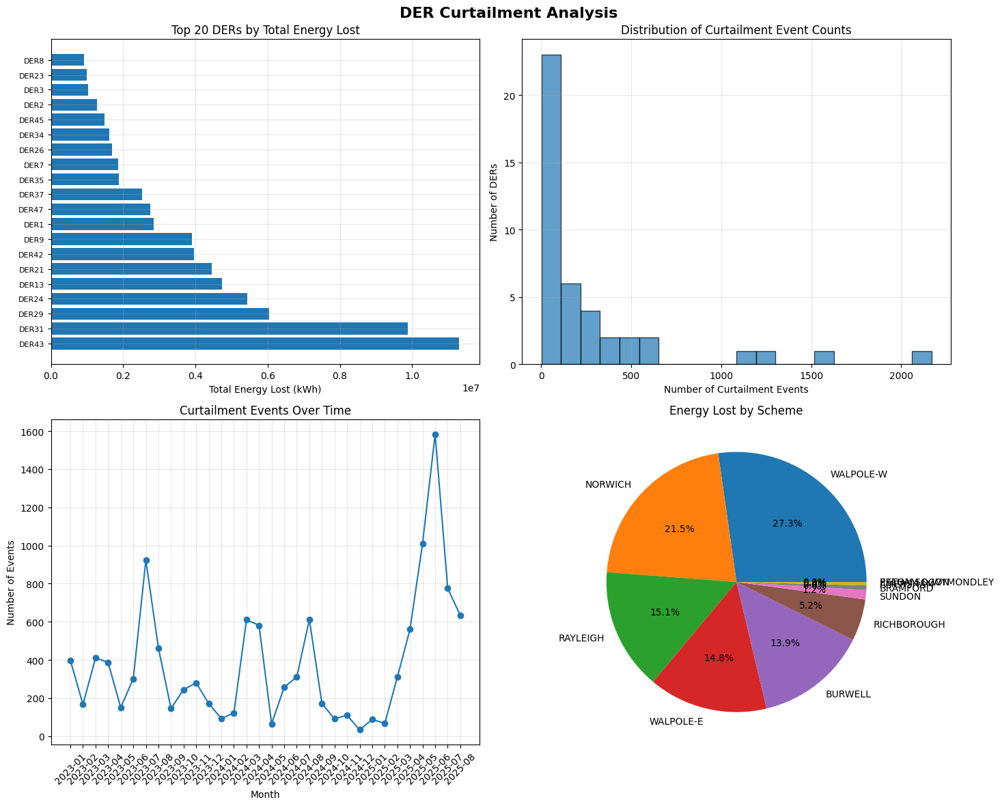

In [134]:
# DER CURTAILMENT ANALYSIS
print("=" * 60)
print("DER CURTAILMENT ANALYSIS")
print("=" * 60)

# Calculate detailed DER statistics
der_stats = curtailment_df.groupby('der_name').agg({
    'total_der_access_reduction_kWh': ['count', 'sum', 'mean', 'max'],
    'duration_hours': ['sum', 'mean', 'max'],
    'scheme_name': lambda x: x.iloc[0]  # Get scheme name
}).round(2)

# Flatten column names
der_stats.columns = [
    'event_count', 'total_energy_lost_kwh', 'avg_energy_per_event', 'max_energy_event',
    'total_duration_hours', 'avg_duration_hours', 'max_duration_hours', 'scheme_name'
]

# Add derived metrics
der_stats['avg_events_per_day'] = (der_stats['event_count'] / 
                                  (curtailment_df['start_time_utc'].max() - curtailment_df['start_time_utc'].min()).days).round(3)

# Sort by total energy lost
der_stats_sorted = der_stats.sort_values('total_energy_lost_kwh', ascending=False)

print(f"\nDER CURTAILMENT STATISTICS")
print(f"Total DERs with curtailment events: {len(der_stats_sorted)}")
print(f"Total curtailment events: {curtailment_df.shape[0]:,}")
print(f"Total energy lost: {curtailment_df['total_der_access_reduction_kWh'].sum():,.0f} kWh")
print(f"Date range: {curtailment_df['start_time_utc'].min()} to {curtailment_df['start_time_utc'].max()}")

print(f"\nTOP 15 MOST IMPACTED DERs (by total energy lost):")
print(der_stats_sorted.head(15)[['event_count', 'total_energy_lost_kwh', 'avg_energy_per_event', 'total_duration_hours', 'avg_events_per_day', 'scheme_name']])

# Save detailed DER statistics
der_output_file = os.path.join(OUTPUT_DIR, 'der_curtailment_statistics.csv')
der_stats_sorted.to_csv(der_output_file)
print(f"\nDetailed DER statistics saved to: {der_output_file}")

# Create DER curtailment chart
import matplotlib.pyplot as plt

fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('DER Curtailment Analysis', fontsize=16, fontweight='bold')

# Chart 1: Top 20 DERs by total energy lost
top_ders = der_stats_sorted.head(20)
ax1.barh(range(len(top_ders)), top_ders['total_energy_lost_kwh'])
ax1.set_yticks(range(len(top_ders)))
ax1.set_yticklabels(top_ders.index, fontsize=8)
ax1.set_xlabel('Total Energy Lost (kWh)')
ax1.set_title('Top 20 DERs by Total Energy Lost')
ax1.grid(True, alpha=0.3)

# Chart 2: Distribution of event counts
ax2.hist(der_stats['event_count'], bins=20, edgecolor='black', alpha=0.7)
ax2.set_xlabel('Number of Curtailment Events')
ax2.set_ylabel('Number of DERs')
ax2.set_title('Distribution of Curtailment Event Counts')
ax2.grid(True, alpha=0.3)

# Chart 3: Curtailment events over time (monthly)
curtailment_df['month'] = curtailment_df['start_time_utc'].dt.to_period('M')
monthly_curtailments = curtailment_df.groupby('month').agg({
    'der_name': 'count',
    'total_der_access_reduction_kWh': 'sum'
})
monthly_curtailments.index = monthly_curtailments.index.astype(str)

ax3.plot(monthly_curtailments.index, monthly_curtailments['der_name'], marker='o')
ax3.set_xlabel('Month')
ax3.set_ylabel('Number of Events')
ax3.set_title('Curtailment Events Over Time')
ax3.tick_params(axis='x', rotation=45)
ax3.grid(True, alpha=0.3)

# Chart 4: Energy lost by scheme
scheme_stats = der_stats.groupby('scheme_name').agg({
    'total_energy_lost_kwh': 'sum',
    'event_count': 'sum'
}).sort_values('total_energy_lost_kwh', ascending=False)

ax4.pie(scheme_stats['total_energy_lost_kwh'], labels=scheme_stats.index, autopct='%1.1f%%')
ax4.set_title('Energy Lost by Scheme')

plt.tight_layout()
chart_file = os.path.join(OUTPUT_DIR, 'der_curtailment_analysis.png')
plt.savefig(chart_file, dpi=300, bbox_inches='tight')
print(f"DER analysis charts saved to: {chart_file}")
plt.show()


CONSTRAINT BREACH ANALYSIS

CONSTRAINT BREACH STATISTICS
Total unique constraints with breaches: 31
Total breach events: 13,214
Total energy reduction due to breaches: 26,966,479 kWh
Date range: 2023-01-01 01:11:01+00:00 to 2025-08-22 12:45:16+00:00

TOP 15 MOST PROBLEMATIC CONSTRAINTS (by breach count):
                                                    breach_count  \
constraint_description                                             
PETERBOROUGH CENTRAL 132/33KV  - FARCET 1 33KV OHL          7347   
PETERBOROUGH CENTRAL 132/33KV - FARCET PRIMARY ...          3078   
HEMPTON GRID 132/33 KV - BURNHAM THORPE TEE HUN...           850   
THORNHAM SOLAR FARM  - HUNSTANTON - THORNAM SOL...           532   
BURWELL LOCAL GRID 132/33KV - SUM                            305   
HEMPTON GRID 132/33 KV - SUM                                 238   
WALPOLE 132 KV - KINGS LYNN PWR STATION OHL SUM...           168   
BURY GRID 132/33KV - SUM                                     158   
BRITISH SUGAR 

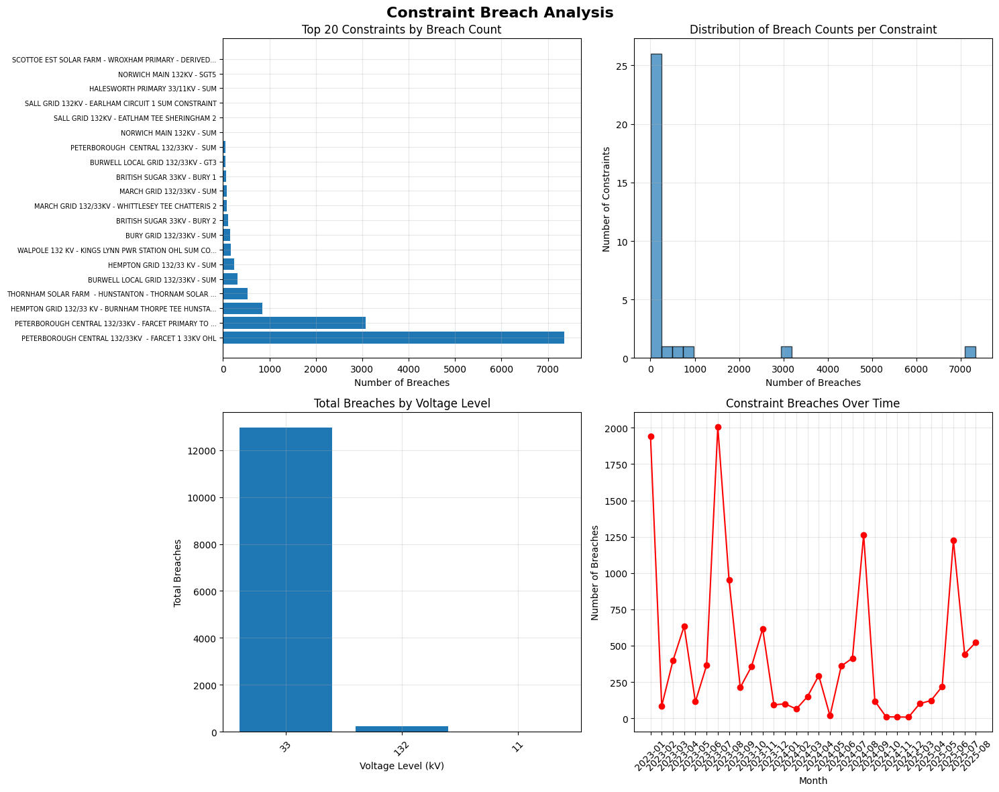

In [135]:
# CONSTRAINT BREACH ANALYSIS
print("=" * 60)
print("CONSTRAINT BREACH ANALYSIS")
print("=" * 60)

# Calculate detailed constraint breach statistics
constraint_stats = breaches_df.groupby('constraint_description').agg({
    'total_der_access_reduction_kWh': ['count', 'sum', 'mean', 'max'],
    'duration_hours': ['sum', 'mean', 'max'],
    'constraint_voltage_kV': lambda x: x.iloc[0],  # Get voltage level
    'constraint_id': lambda x: x.iloc[0]  # Get constraint ID
}).round(2)

# Flatten column names
constraint_stats.columns = [
    'breach_count', 'total_energy_reduction_kwh', 'avg_energy_per_breach', 'max_energy_breach',
    'total_duration_hours', 'avg_duration_hours', 'max_duration_hours', 'voltage_kv', 'constraint_id'
]

# Add derived metrics
constraint_stats['avg_breaches_per_day'] = (constraint_stats['breach_count'] / 
                                           (breaches_df['start_time_utc'].max() - breaches_df['start_time_utc'].min()).days).round(3)

# Sort by breach count
constraint_stats_sorted = constraint_stats.sort_values('breach_count', ascending=False)

print(f"\nCONSTRAINT BREACH STATISTICS")
print(f"Total unique constraints with breaches: {len(constraint_stats_sorted)}")
print(f"Total breach events: {breaches_df.shape[0]:,}")
print(f"Total energy reduction due to breaches: {breaches_df['total_der_access_reduction_kWh'].sum():,.0f} kWh")
print(f"Date range: {breaches_df['start_time_utc'].min()} to {breaches_df['start_time_utc'].max()}")

print(f"\nTOP 15 MOST PROBLEMATIC CONSTRAINTS (by breach count):")
print(constraint_stats_sorted.head(15)[['breach_count', 'total_energy_reduction_kwh', 'avg_energy_per_breach', 'total_duration_hours', 'avg_breaches_per_day', 'voltage_kv']])

# Voltage level analysis
voltage_analysis = constraint_stats.groupby('voltage_kv').agg({
    'breach_count': ['sum', 'mean'],
    'total_energy_reduction_kwh': 'sum'
}).round(2)
voltage_analysis.columns = ['total_breaches', 'avg_breaches_per_constraint', 'total_energy_reduction']
voltage_analysis_sorted = voltage_analysis.sort_values('total_breaches', ascending=False)

print(f"\nBREACHES BY VOLTAGE LEVEL:")
print(voltage_analysis_sorted)

# Save detailed constraint statistics
constraint_output_file = os.path.join(OUTPUT_DIR, 'constraint_breach_statistics.csv')
constraint_stats_sorted.to_csv(constraint_output_file)
print(f"\nDetailed constraint statistics saved to: {constraint_output_file}")

# Create constraint breach charts
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('Constraint Breach Analysis', fontsize=16, fontweight='bold')

# Chart 1: Top 20 constraints by breach count
top_constraints = constraint_stats_sorted.head(20)
constraint_names = [desc[:50] + '...' if len(desc) > 50 else desc for desc in top_constraints.index]
ax1.barh(range(len(top_constraints)), top_constraints['breach_count'])
ax1.set_yticks(range(len(top_constraints)))
ax1.set_yticklabels(constraint_names, fontsize=7)
ax1.set_xlabel('Number of Breaches')
ax1.set_title('Top 20 Constraints by Breach Count')
ax1.grid(True, alpha=0.3)

# Chart 2: Breach count distribution
ax2.hist(constraint_stats['breach_count'], bins=30, edgecolor='black', alpha=0.7)
ax2.set_xlabel('Number of Breaches')
ax2.set_ylabel('Number of Constraints')
ax2.set_title('Distribution of Breach Counts per Constraint')
ax2.grid(True, alpha=0.3)

# Chart 3: Breaches by voltage level
voltage_counts = constraint_stats.groupby('voltage_kv')['breach_count'].sum().sort_values(ascending=False)
ax3.bar(voltage_counts.index.astype(str), voltage_counts.values)
ax3.set_xlabel('Voltage Level (kV)')
ax3.set_ylabel('Total Breaches')
ax3.set_title('Total Breaches by Voltage Level')
ax3.tick_params(axis='x', rotation=45)
ax3.grid(True, alpha=0.3)

# Chart 4: Breach events over time (monthly)
breaches_df['month'] = breaches_df['start_time_utc'].dt.to_period('M')
monthly_breaches = breaches_df.groupby('month').agg({
    'constraint_id': 'count',
    'total_der_access_reduction_kWh': 'sum'
})
monthly_breaches.index = monthly_breaches.index.astype(str)

ax4.plot(monthly_breaches.index, monthly_breaches['constraint_id'], marker='o', color='red')
ax4.set_xlabel('Month')
ax4.set_ylabel('Number of Breaches')
ax4.set_title('Constraint Breaches Over Time')
ax4.tick_params(axis='x', rotation=45)
ax4.grid(True, alpha=0.3)

plt.tight_layout()
constraint_chart_file = os.path.join(OUTPUT_DIR, 'constraint_breach_analysis.png')
plt.savefig(constraint_chart_file, dpi=300, bbox_inches='tight')
print(f"Constraint analysis charts saved to: {constraint_chart_file}")
plt.show()


In [140]:
# Add layer control and display map
print("=" * 60)
print("FINALIZING MAP")
print("=" * 60)

# Add layer control
folium.LayerControl().add_to(m)

# Save map
map_file = os.path.join(OUTPUT_DIR, 'constraint_breach_time_visualization.html')
m.save(map_file)

print(f"Map saved to: {map_file}")
print("\n" + "=" * 60)
print("VISUALIZATION COMPLETE")
print("=" * 60)
print("The interactive map shows:")
print("1. ECR sites (blue markers) - static layer")
print("2. Constraint breaches (red markers) - time-animated")
print("3. Use the time slider to see breaches over time")
print("4. Click markers for detailed information")
print(f"\nOpen the map file in a browser: {map_file}")

# Display the map in notebook
m


FINALIZING MAP
Map saved to: /Users/aron/project-overflow/outputs/constraint_breach_time_visualization.html

VISUALIZATION COMPLETE
The interactive map shows:
1. ECR sites (blue markers) - static layer
2. Constraint breaches (red markers) - time-animated
3. Use the time slider to see breaches over time
4. Click markers for detailed information

Open the map file in a browser: /Users/aron/project-overflow/outputs/constraint_breach_time_visualization.html


In [137]:
# Create summary of temporal correlations
print("=" * 60)
print("TEMPORAL CORRELATION ANALYSIS")
print("=" * 60)

# Create hourly summary of both breaches and curtailments
hourly_summary = []

for hour in all_hours:
    hour_breaches = breaches_with_location[breaches_with_location['hour'] == hour]
    hour_curtailments = curtailment_df[curtailment_df['hour'] == hour]
    
    summary = {
        'hour': hour,
        'breach_count': len(hour_breaches),
        'curtailment_count': len(hour_curtailments),
        'breach_locations': ', '.join(hour_breaches['constraint_description_breach'].unique()) if len(hour_breaches) > 0 else '',
        'der_list': ', '.join(hour_curtailments['der_name'].unique()) if len(hour_curtailments) > 0 else '',
        'total_curtailed_kwh': hour_curtailments['total_der_access_reduction_kWh'].sum() if len(hour_curtailments) > 0 else 0
    }
    hourly_summary.append(summary)

summary_df = pd.DataFrame(hourly_summary)

# Show hours with both breaches and curtailments
correlated_hours = summary_df[(summary_df['breach_count'] > 0) & (summary_df['curtailment_count'] > 0)]

print(f"Found {len(correlated_hours)} hours with both breaches and curtailments:")
print(correlated_hours[['hour', 'breach_count', 'curtailment_count', 'breach_locations', 'der_list']].head(10))

# Save summary
summary_file = os.path.join(OUTPUT_DIR, 'temporal_correlation_summary.csv')
summary_df.to_csv(summary_file, index=False)
print(f"\nTemporal correlation summary saved to: {summary_file}")


TEMPORAL CORRELATION ANALYSIS
Found 1153 hours with both breaches and curtailments:
                        hour  breach_count  curtailment_count  \
0  2023-01-01 01:00:00+00:00            17                  5   
1  2023-01-01 02:00:00+00:00            19                  6   
2  2023-01-01 03:00:00+00:00             6                  1   
3  2023-01-01 04:00:00+00:00             1                  6   
4  2023-01-01 06:00:00+00:00             3                  7   
8  2023-01-03 10:00:00+00:00            14                  4   
11 2023-01-03 15:00:00+00:00             3                  5   
12 2023-01-03 16:00:00+00:00            13                  6   
32 2023-01-04 12:00:00+00:00            11                  6   
34 2023-01-04 14:00:00+00:00            17                  5   

                                     breach_locations  \
0   PETERBOROUGH CENTRAL 132/33KV  - FARCET 1 33KV...   
1   PETERBOROUGH CENTRAL 132/33KV  - FARCET 1 33KV...   
2   PETERBOROUGH CENTRAL 132/